In [1]:
# !pip install tensorflow --user
# !pip install numpy==1.24.4 --user
# !pip cache purge

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

print(f"NumPy version: {np.__version__}")
print(f"NumPy path: {np.__file__}")

NumPy version: 1.24.4
NumPy path: C:\Users\zhafr\AppData\Roaming\Python\Python39\site-packages\numpy\__init__.py


In [3]:
train = pd.read_csv('train.csv', parse_dates = ['date'])
train

,date,store,item,sales
0,2013-01-01,1,1,13
1,2013-01-02,1,1,11
2,2013-01-03,1,1,14
3,2013-01-04,1,1,13
4,2013-01-05,1,1,10
...,...,...,...,...
912995,2017-12-27,10,50,63
912996,2017-12-28,10,50,59
912997,2017-12-29,10,50,74
912998,2017-12-30,10,50,62


In [4]:
test = pd.read_csv('test.csv', parse_dates = ['date'])
test

,id,date,store,item
0,0,2018-01-01,1,1
1,1,2018-01-02,1,1
2,2,2018-01-03,1,1
3,3,2018-01-04,1,1
4,4,2018-01-05,1,1
...,...,...,...,...
44995,44995,2018-03-27,10,50
44996,44996,2018-03-28,10,50
44997,44997,2018-03-29,10,50
44998,44998,2018-03-30,10,50


In [5]:
print('Min date from train set: ' + str(train['date'].min().date()))
print('Max date from train set: ' + str(train['date'].max().date()))

Min date from train set: 2013-01-01
Max date from train set: 2017-12-31


In [6]:
lag_size = (test['date'].max().date() - train['date'].max().date()).days

print('Max date from train set: '+ str(train['date'].max().date()))
print('Max date from test set: ' + str(test['date'].max().date()))
print('Forecast lag size:', lag_size, 'days')

Max date from train set: 2017-12-31
Max date from test set: 2018-03-31
Forecast lag size: 90 days


In [7]:
dates = train.groupby('date', as_index=False)['sales'].sum()
stores = train.groupby(['store', 'date'], as_index=False)['sales'].sum()
items = train.groupby(['item', 'date'], as_index=False)['sales'].sum()

In [8]:
dates

,date,sales
0,2013-01-01,13696
1,2013-01-02,13678
2,2013-01-03,14488
3,2013-01-04,15677
4,2013-01-05,16237
...,...,...
1821,2017-12-27,20378
1822,2017-12-28,21885
1823,2017-12-29,23535
1824,2017-12-30,24988


In [9]:
stores

,store,date,sales
0,1,2013-01-01,1316
1,1,2013-01-02,1264
2,1,2013-01-03,1305
3,1,2013-01-04,1452
4,1,2013-01-05,1499
...,...,...,...
18255,10,2017-12-27,2221
18256,10,2017-12-28,2429
18257,10,2017-12-29,2687
18258,10,2017-12-30,2742


In [10]:
items

,item,date,sales
0,1,2013-01-01,133
1,1,2013-01-02,99
2,1,2013-01-03,127
3,1,2013-01-04,145
4,1,2013-01-05,149
...,...,...,...
91295,50,2017-12-27,511
91296,50,2017-12-28,587
91297,50,2017-12-29,596
91298,50,2017-12-30,612


In [11]:
import plotly.graph_objs as go
from plotly.offline import iplot

plot_dates = go.Scatter(x=dates['date'], y=dates['sales'])
layout = go.Layout(title='Daily sales', xaxis=dict(title='Date'), yaxis=dict(title='Sales'))

fig = go.Figure(data=[plot_dates], layout=layout)
iplot(fig)

In [12]:
plot_stores = []

for store in stores['store'].unique():
    c_store = stores[(stores['store'] == store)]
    plot_stores.append(go.Scatter(x=c_store['date'], y=c_store['sales'], name=('Store ' + str(store))))
    
layout = go.Layout(title='Store daily sales', xaxis=dict(title='Date'), yaxis=dict(title='Sales'))

fig = go.Figure(data=plot_stores, layout=layout)
iplot(fig)

In [13]:
plot_items = []

for item in items['item'].unique():
    c_items = items[(items['item'] == item)]
    plot_items.append(go.Scatter(x=c_items['date'],y=c_items['sales'], name=('Item ' + str(item))))
    
layout = go.Layout(title='Item daily sales', xaxis=dict(title='Date'), yaxis=dict(title='Sales'))

fig = go.Figure(data=plot_items, layout=layout)
iplot(fig)

In [14]:
# Empty list to store the index/date of the train dataframe
indexes_train = []

# Add a for loop to calculate the combination of unique data in the store and item columns
for i in range(train.store.nunique()*train.item.nunique()):
    indexes_train = np.append(indexes_train, np.linspace(0, train.date.nunique()-1, train.date.nunique(), dtype=int))
    i=+1

indexes_train

array([0.000e+00, 1.000e+00, 2.000e+00, ..., 1.823e+03, 1.824e+03,
       1.825e+03])

In [15]:
train["indexes"] = indexes_train
train

,date,store,item,sales,indexes
0,2013-01-01,1,1,13,0.0
1,2013-01-02,1,1,11,1.0
2,2013-01-03,1,1,14,2.0
3,2013-01-04,1,1,13,3.0
4,2013-01-05,1,1,10,4.0
...,...,...,...,...,...
912995,2017-12-27,10,50,63,1821.0
912996,2017-12-28,10,50,59,1822.0
912997,2017-12-29,10,50,74,1823.0
912998,2017-12-30,10,50,62,1824.0


In [16]:
# Empty list to store the index/date of the test dataframe
indexes_test = []

# Add a for loop to calculate the combination of unique data in the store and item columns
for i in range(test.store.nunique()*test.item.nunique()):
    indexes_test = np.append(indexes_test, np.linspace(0, test.date.nunique()-1, test.date.nunique(), dtype=int))
    i=+1

indexes_test

array([ 0.,  1.,  2., ..., 87., 88., 89.])

In [17]:
test["indexes"] = indexes_test
test

,id,date,store,item,indexes
0,0,2018-01-01,1,1,0.0
1,1,2018-01-02,1,1,1.0
2,2,2018-01-03,1,1,2.0
3,3,2018-01-04,1,1,3.0
4,4,2018-01-05,1,1,4.0
...,...,...,...,...,...
44995,44995,2018-03-27,10,50,85.0
44996,44996,2018-03-28,10,50,86.0
44997,44997,2018-03-29,10,50,87.0
44998,44998,2018-03-30,10,50,88.0


In [18]:
data= pd.concat([train, test], sort=False)
data

,date,store,item,sales,indexes,id
0,2013-01-01,1,1,13.0,0.0,NaN
1,2013-01-02,1,1,11.0,1.0,NaN
2,2013-01-03,1,1,14.0,2.0,NaN
3,2013-01-04,1,1,13.0,3.0,NaN
4,2013-01-05,1,1,10.0,4.0,NaN
...,...,...,...,...,...,...
44995,2018-03-27,10,50,NaN,85.0,44995.0
44996,2018-03-28,10,50,NaN,86.0,44996.0
44997,2018-03-29,10,50,NaN,87.0,44997.0
44998,2018-03-30,10,50,NaN,88.0,44998.0


In [19]:
minute = 60 #seconds
hour = 60*minute
day  = 24*hour
week = 7*day
year = 365.2425*day

df1 = data.copy()
df1["index_second"] = df1["indexes"]*day

df1

,date,store,item,sales,indexes,id,index_second
0,2013-01-01,1,1,13.0,0.0,NaN,0.0
1,2013-01-02,1,1,11.0,1.0,NaN,86400.0
2,2013-01-03,1,1,14.0,2.0,NaN,172800.0
3,2013-01-04,1,1,13.0,3.0,NaN,259200.0
4,2013-01-05,1,1,10.0,4.0,NaN,345600.0
...,...,...,...,...,...,...,...
44995,2018-03-27,10,50,NaN,85.0,44995.0,7344000.0
44996,2018-03-28,10,50,NaN,86.0,44996.0,7430400.0
44997,2018-03-29,10,50,NaN,87.0,44997.0,7516800.0
44998,2018-03-30,10,50,NaN,88.0,44998.0,7603200.0


In [20]:
df1["YEAR_index_norm"] = 2 * np.pi * df1["index_second"] / year
df1["YEAR_cos_index"] = np.cos(df1["YEAR_index_norm"])
df1["YEAR_sin_index"] = np.sin(df1["YEAR_index_norm"])

df1

,date,store,item,sales,indexes,id,index_second,YEAR_index_norm,YEAR_cos_index,YEAR_sin_index
0,2013-01-01,1,1,13.0,0.0,NaN,0.0,0.000000,1.000000,0.000000
1,2013-01-02,1,1,11.0,1.0,NaN,86400.0,0.017203,0.999852,0.017202
2,2013-01-03,1,1,14.0,2.0,NaN,172800.0,0.034406,0.999408,0.034399
3,2013-01-04,1,1,13.0,3.0,NaN,259200.0,0.051608,0.998669,0.051585
4,2013-01-05,1,1,10.0,4.0,NaN,345600.0,0.068811,0.997633,0.068757
...,...,...,...,...,...,...,...,...,...,...
44995,2018-03-27,10,50,NaN,85.0,44995.0,7344000.0,1.462236,0.108347,0.994113
44996,2018-03-28,10,50,NaN,86.0,44996.0,7430400.0,1.479439,0.091230,0.995830
44997,2018-03-29,10,50,NaN,87.0,44997.0,7516800.0,1.496642,0.074087,0.997252
44998,2018-03-30,10,50,NaN,88.0,44998.0,7603200.0,1.513844,0.056921,0.998379


<AxesSubplot:>

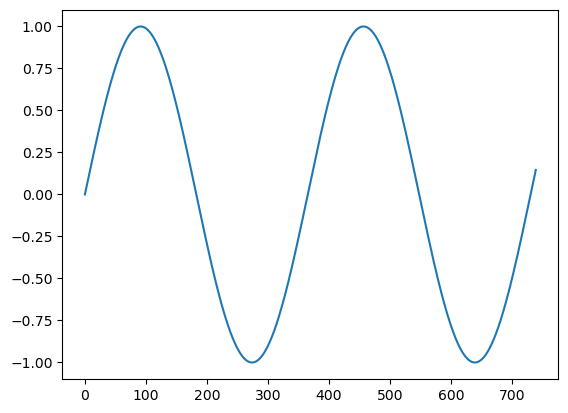

In [21]:
df1.iloc[0:740, 9].plot()

In [22]:
df2 = df1.drop(["indexes","index_second","YEAR_index_norm"], axis=1) 
df2.head()

,date,store,item,sales,id,YEAR_cos_index,YEAR_sin_index
0,2013-01-01,1,1,13.0,NaN,1.000000,0.000000
1,2013-01-02,1,1,11.0,NaN,0.999852,0.017202
2,2013-01-03,1,1,14.0,NaN,0.999408,0.034399
3,2013-01-04,1,1,13.0,NaN,0.998669,0.051585
4,2013-01-05,1,1,10.0,NaN,0.997633,0.068757


In [23]:
def create_date_time_features(df):
    df = df.copy()
    df['dayofweek'] = df.date.dt.dayofweek
    df['quarter'] = df.date.dt.quarter
    df['month'] = df.date.dt.month
    df['year'] = df.date.dt.year
    df['dayofyear'] = df.date.dt.dayofyear
    df['dayofmonth'] = df.date.dt.day
    df['weekofyear'] = df.date.dt.isocalendar().week.astype("int64")
    df["season"] = np.where(df.month.isin([12,1,2]),0,1)
    df["season"] = np.where(df.month.isin([6,7,8]),2,df["season"])
    df["season"] = np.where(df.month.isin([9, 10,11]),3,df["season"])
    return df

In [24]:
df3 = df2.copy()
df3 = create_date_time_features(df3)

df3

,date,store,item,sales,id,YEAR_cos_index,YEAR_sin_index,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear,season
0,2013-01-01,1,1,13.0,NaN,1.000000,0.000000,1,1,1,2013,1,1,1,0
1,2013-01-02,1,1,11.0,NaN,0.999852,0.017202,2,1,1,2013,2,2,1,0
2,2013-01-03,1,1,14.0,NaN,0.999408,0.034399,3,1,1,2013,3,3,1,0
3,2013-01-04,1,1,13.0,NaN,0.998669,0.051585,4,1,1,2013,4,4,1,0
4,2013-01-05,1,1,10.0,NaN,0.997633,0.068757,5,1,1,2013,5,5,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44995,2018-03-27,10,50,NaN,44995.0,0.108347,0.994113,1,1,3,2018,86,27,13,1
44996,2018-03-28,10,50,NaN,44996.0,0.091230,0.995830,2,1,3,2018,87,28,13,1
44997,2018-03-29,10,50,NaN,44997.0,0.074087,0.997252,3,1,3,2018,88,29,13,1
44998,2018-03-30,10,50,NaN,44998.0,0.056921,0.998379,4,1,3,2018,89,30,13,1


In [25]:
def lag_features(df, lags):
    
    for lag in lags:
        
        df['sales_lag_' + str(lag)] = df.groupby(["store", "item"])['sales'].transform(lambda x: x.shift(lag)) 
        
         #Changing the missing values to 0
        df.fillna(0, inplace=True)
        
    return df

In [26]:
df4 = df3.copy()
lag_features(df4, [91, 98, 105, 112, 119, 126, 182, 364, 546, 728])

df4

,date,store,item,sales,id,YEAR_cos_index,YEAR_sin_index,dayofweek,quarter,month,...,sales_lag_91,sales_lag_98,sales_lag_105,sales_lag_112,sales_lag_119,sales_lag_126,sales_lag_182,sales_lag_364,sales_lag_546,sales_lag_728
0,2013-01-01,1,1,13.0,0.0,1.000000,0.000000,1,1,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2013-01-02,1,1,11.0,0.0,0.999852,0.017202,2,1,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2013-01-03,1,1,14.0,0.0,0.999408,0.034399,3,1,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2013-01-04,1,1,13.0,0.0,0.998669,0.051585,4,1,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2013-01-05,1,1,10.0,0.0,0.997633,0.068757,5,1,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44995,2018-03-27,10,50,0.0,44995.0,0.108347,0.994113,1,1,3,...,41.0,54.0,67.0,68.0,68.0,81.0,79.0,60.0,97.0,73.0
44996,2018-03-28,10,50,0.0,44996.0,0.091230,0.995830,2,1,3,...,63.0,51.0,67.0,60.0,76.0,81.0,80.0,73.0,80.0,68.0
44997,2018-03-29,10,50,0.0,44997.0,0.074087,0.997252,3,1,3,...,59.0,63.0,72.0,66.0,73.0,87.0,82.0,68.0,99.0,75.0
44998,2018-03-30,10,50,0.0,44998.0,0.056921,0.998379,4,1,3,...,74.0,75.0,72.0,67.0,66.0,81.0,90.0,69.0,79.0,83.0


In [27]:
import pandas as pd
import numpy as np
from scipy import signal

# Function to apply the Triangular window manually
def triang_window(x, window_size):
    
    if len(x) == window_size:
        window = signal.get_window('triang', window_size)
        return np.sum(window * x) / np.sum(window)
    else:
        # For windows smaller than the specified window size, use the actual data length
        window = signal.get_window('triang', len(x))
        return np.sum(window * x) / np.sum(window)

# Function to calculate rolling mean with a custom window for each group
def roll_mean_features(df, windows):
    
    for window in windows:
        
        # Apply rolling transformation with custom triang window
        df['sales_roll_mean_' + str(window)] = df.groupby(["store", "item"])['sales'].transform(
            lambda x: x.shift(1).rolling(window=window, min_periods=10).apply(lambda y: triang_window(y, window), raw=True)
        )
        
        df.fillna(0, inplace=True)
        
    return df

In [28]:
df5 = df4.copy()
df5 = roll_mean_features(df5, [365, 546])

df5.tail(10)

,date,store,item,sales,id,YEAR_cos_index,YEAR_sin_index,dayofweek,quarter,month,...,sales_lag_105,sales_lag_112,sales_lag_119,sales_lag_126,sales_lag_182,sales_lag_364,sales_lag_546,sales_lag_728,sales_roll_mean_365,sales_roll_mean_546
44990,2018-03-22,10,50,0.0,44990.0,0.193349,0.981130,3,1,3,...,66.0,73.0,87.0,84.0,89.0,67.0,89.0,73.0,79.742852,81.947293
44991,2018-03-23,10,50,0.0,44991.0,0.176443,0.984311,4,1,3,...,67.0,66.0,81.0,95.0,97.0,73.0,82.0,74.0,79.463308,81.884276
44992,2018-03-24,10,50,0.0,44992.0,0.159485,0.987200,5,1,3,...,69.0,49.0,78.0,99.0,97.0,79.0,97.0,79.0,79.180062,81.819860
44993,2018-03-25,10,50,0.0,44993.0,0.142479,0.989798,6,1,3,...,69.0,75.0,113.0,88.0,99.0,81.0,114.0,83.0,78.893113,81.753100
44994,2018-03-26,10,50,0.0,44994.0,0.125432,0.992102,0,1,3,...,54.0,54.0,75.0,62.0,63.0,66.0,46.0,51.0,78.602580,81.684782
44995,2018-03-27,10,50,0.0,44995.0,0.108347,0.994113,1,1,3,...,67.0,68.0,68.0,81.0,79.0,60.0,97.0,73.0,78.309599,81.615798
44996,2018-03-28,10,50,0.0,44996.0,0.091230,0.995830,2,1,3,...,67.0,60.0,76.0,81.0,80.0,73.0,80.0,68.0,78.014572,81.545215
44997,2018-03-29,10,50,0.0,44997.0,0.074087,0.997252,3,1,3,...,72.0,66.0,73.0,87.0,82.0,68.0,99.0,75.0,77.716679,81.473500
44998,2018-03-30,10,50,0.0,44998.0,0.056921,0.998379,4,1,3,...,72.0,67.0,66.0,81.0,90.0,69.0,79.0,83.0,77.415934,81.399600
44999,2018-03-31,10,50,0.0,44999.0,0.039739,0.999210,5,1,3,...,52.0,69.0,49.0,78.0,103.0,101.0,97.0,82.0,77.112158,81.324036


In [29]:
def ewm_features(dataframe, alphas, lags):
    
    for alpha in alphas:
        for lag in lags:
            dataframe['sales_ewm_alpha_' + str(alpha).replace(".", "") + "_lag_" + str(lag)] = dataframe.groupby(["store", "item"])['sales'].transform(lambda x: x.shift(lag).ewm(alpha=alpha).mean())
    
    dataframe.fillna(0, inplace=True)
    
    return dataframe

In [30]:
alphas = [0.95, 0.9, 0.8, 0.7, 0.5]
lags = [91, 98, 105, 112, 180, 270, 365, 546, 728]

df6 = df5.copy()
df6 = ewm_features(df6, alphas, lags)

df6.tail()

,date,store,item,sales,id,YEAR_cos_index,YEAR_sin_index,dayofweek,quarter,month,...,sales_ewm_alpha_07_lag_728,sales_ewm_alpha_05_lag_91,sales_ewm_alpha_05_lag_98,sales_ewm_alpha_05_lag_105,sales_ewm_alpha_05_lag_112,sales_ewm_alpha_05_lag_180,sales_ewm_alpha_05_lag_270,sales_ewm_alpha_05_lag_365,sales_ewm_alpha_05_lag_546,sales_ewm_alpha_05_lag_728
44995,2018-03-27,10,50,0.0,44995.0,0.108347,0.994113,1,1,3,...,69.116907,51.309755,58.648702,64.033868,64.335072,80.828687,109.036310,71.734958,85.489012,68.933911
44996,2018-03-28,10,50,0.0,44996.0,0.091230,0.995830,2,1,3,...,68.335072,57.154878,54.824351,65.516934,62.167536,85.414343,114.018155,65.867479,82.744506,68.466956
44997,2018-03-29,10,50,0.0,44997.0,0.074087,0.997252,3,1,3,...,73.000522,58.077439,58.912176,68.758467,64.083768,94.207172,117.009078,69.433740,90.872253,71.733478
44998,2018-03-30,10,50,0.0,44998.0,0.056921,0.998379,4,1,3,...,80.000156,66.038719,66.956088,70.379233,65.541884,96.603586,108.004539,68.716870,84.936127,77.366739
44999,2018-03-31,10,50,0.0,44999.0,0.039739,0.999210,5,1,3,...,81.400047,64.019360,68.478044,61.189617,67.270942,83.801793,103.002269,68.858435,90.968063,79.683369


In [31]:
df7 = pd.get_dummies(df6, columns=['store', 'item', 'dayofweek', "quarter", 'month', "year", "season"])
df7.head()

,date,sales,id,YEAR_cos_index,YEAR_sin_index,dayofyear,dayofmonth,weekofyear,sales_lag_91,sales_lag_98,...,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018,season_0,season_1,season_2,season_3
0,2013-01-01,13.0,0.0,1.000000,0.000000,1,1,1,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
1,2013-01-02,11.0,0.0,0.999852,0.017202,2,2,1,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
2,2013-01-03,14.0,0.0,0.999408,0.034399,3,3,1,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
3,2013-01-04,13.0,0.0,0.998669,0.051585,4,4,1,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
4,2013-01-05,10.0,0.0,0.997633,0.068757,5,5,1,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0


In [32]:
df7['sales'] = np.log1p(df7["sales"].values)
df7.head()

,date,sales,id,YEAR_cos_index,YEAR_sin_index,dayofyear,dayofmonth,weekofyear,sales_lag_91,sales_lag_98,...,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018,season_0,season_1,season_2,season_3
0,2013-01-01,2.639057,0.0,1.000000,0.000000,1,1,1,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
1,2013-01-02,2.484907,0.0,0.999852,0.017202,2,2,1,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
2,2013-01-03,2.708050,0.0,0.999408,0.034399,3,3,1,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
3,2013-01-04,2.639057,0.0,0.998669,0.051585,4,4,1,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
4,2013-01-05,2.397895,0.0,0.997633,0.068757,5,5,1,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0


In [33]:
print(df7['sales'].max())
print(df7['sales'].min())
print(df7['sales'].mean())

5.44673737166631
0.0
3.640985941694262


In [34]:
df_model = df7.copy()
df_model = df_model.sort_values("date").reset_index(drop = True)

train = df_model.loc[(df_model["date"] <  "2017-01-01"), :]
validation = df_model.loc[(df_model["date"] >= "2017-01-01") & (df_model["date"] < "2017-04-01"), :]

In [35]:
train

,date,sales,id,YEAR_cos_index,YEAR_sin_index,dayofyear,dayofmonth,weekofyear,sales_lag_91,sales_lag_98,...,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018,season_0,season_1,season_2,season_3
0,2013-01-01,2.639057,0.0,1.000000,0.000000,1,1,1,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
1,2013-01-01,2.833213,0.0,1.000000,0.000000,1,1,1,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
2,2013-01-01,3.044522,0.0,1.000000,0.000000,1,1,1,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
3,2013-01-01,3.555348,0.0,1.000000,0.000000,1,1,1,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
4,2013-01-01,2.995732,0.0,1.000000,0.000000,1,1,1,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
730495,2016-12-31,4.060443,0.0,0.999861,-0.016686,366,31,52,75.0,61.0,...,0,0,0,1,0,0,1,0,0,0
730496,2016-12-31,3.610918,0.0,0.999861,-0.016686,366,31,52,48.0,54.0,...,0,0,0,1,0,0,1,0,0,0
730497,2016-12-31,3.367296,0.0,0.999861,-0.016686,366,31,52,44.0,33.0,...,0,0,0,1,0,0,1,0,0,0
730498,2016-12-31,4.025352,0.0,0.999861,-0.016686,366,31,52,59.0,75.0,...,0,0,0,1,0,0,1,0,0,0


In [36]:
validation

,date,sales,id,YEAR_cos_index,YEAR_sin_index,dayofyear,dayofmonth,weekofyear,sales_lag_91,sales_lag_98,...,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018,season_0,season_1,season_2,season_3
730500,2017-01-01,3.663562,0.0,1.000000,0.000516,1,1,52,49.0,59.0,...,0,0,0,0,1,0,1,0,0,0
730501,2017-01-01,4.682131,0.0,1.000000,0.000516,1,1,52,131.0,167.0,...,0,0,0,0,1,0,1,0,0,0
730502,2017-01-01,4.077537,0.0,1.000000,0.000516,1,1,52,69.0,84.0,...,0,0,0,0,1,0,1,0,0,0
730503,2017-01-01,3.295837,0.0,1.000000,0.000516,1,1,52,40.0,34.0,...,0,0,0,0,1,0,1,0,0,0
730504,2017-01-01,3.367296,0.0,1.000000,0.000516,1,1,52,38.0,37.0,...,0,0,0,0,1,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
775495,2017-03-31,4.406719,0.0,0.039223,0.999230,90,31,13,55.0,62.0,...,0,0,0,0,1,0,0,1,0,0
775496,2017-03-31,3.555348,0.0,0.039223,0.999230,90,31,13,26.0,24.0,...,0,0,0,0,1,0,0,1,0,0
775497,2017-03-31,3.784190,0.0,0.039223,0.999230,90,31,13,33.0,30.0,...,0,0,0,0,1,0,0,1,0,0
775498,2017-03-31,3.988984,0.0,0.039223,0.999230,90,31,13,38.0,44.0,...,0,0,0,0,1,0,0,1,0,0


In [37]:
cols = [col for col in train.columns if col not in ['date', 'id', "sales", "year"]]

X_train = train[cols]
Y_train = train['sales']

X_val = validation[cols]
Y_val = validation['sales']

X_train

,YEAR_cos_index,YEAR_sin_index,dayofyear,dayofmonth,weekofyear,sales_lag_91,sales_lag_98,sales_lag_105,sales_lag_112,sales_lag_119,...,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018,season_0,season_1,season_2,season_3
0,1.000000,0.000000,1,1,1,0.0,0.0,0.0,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
1,1.000000,0.000000,1,1,1,0.0,0.0,0.0,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
2,1.000000,0.000000,1,1,1,0.0,0.0,0.0,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
3,1.000000,0.000000,1,1,1,0.0,0.0,0.0,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
4,1.000000,0.000000,1,1,1,0.0,0.0,0.0,0.0,0.0,...,1,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
730495,0.999861,-0.016686,366,31,52,75.0,61.0,88.0,65.0,52.0,...,0,0,0,1,0,0,1,0,0,0
730496,0.999861,-0.016686,366,31,52,48.0,54.0,53.0,49.0,46.0,...,0,0,0,1,0,0,1,0,0,0
730497,0.999861,-0.016686,366,31,52,44.0,33.0,35.0,32.0,47.0,...,0,0,0,1,0,0,1,0,0,0
730498,0.999861,-0.016686,366,31,52,59.0,75.0,73.0,58.0,68.0,...,0,0,0,1,0,0,1,0,0,0


In [38]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import Adam
from keras import metrics
import tensorflow as tf

In [39]:
NN_model = Sequential()

# Input Layer contains of 128 Neurons that are Dense Layer (all Neuron connected to all neurons in the next layer)
# The number of dimensions of this layer is as much as the number of feature columns in the previous feature engineering stage
# Activation Function that is used is ReLU (Rectified Linear Unit)
NN_model.add(Dense(128, kernel_initializer='normal',input_dim = X_train.shape[1], activation='relu'))

# 3 Hidden Layer (Dense) that each of the layer has 256 Neuron, using ReLU Activation Function
NN_model.add(Dense(256, kernel_initializer='normal', activation='relu'))
NN_model.add(Dense(256, kernel_initializer='normal', activation='relu'))
NN_model.add(Dense(256, kernel_initializer='normal', activation='relu'))

# Dropout Layer in a Neural Network which is usually used to avoid Overfitting in the model
# Parameter rate value of 20% to reduce model complexity
NN_model.add(Dropout(0.2))

# Output Layer with 1 Neuron which is the result of regression prediction
# To later determine the sales value of the input features using Linear activation
NN_model.add(Dense(1, kernel_initializer='normal', activation='linear'))

# Do compiling layer in the Neural Network model using ADAM Optimizer
NN_model.compile(loss=tf.keras.losses.mae, optimizer="adam", metrics=['mae'])

NN_model.summary()

C:\Users\zhafr\AppData\Roaming\Python\Python39\site-packages\keras\src\layers\core\dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 128)            │        19,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 256)            │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 184,833 (722.00 KB)

 Trainable params: 184,833 (722.00 KB)

 Non-trainable params: 0 (0.00 B)

In [40]:
# epoch = number of iterations that repeated for training the model
# batch_size = number of data samples used to train into a network each process enters a neuron or each training batch
# validation_split = percentage of training data used as data validation during the training process 
NN_model.fit(X_train.values, Y_train.values, epochs=2, batch_size=32, validation_split = 0.2)

Epoch 1/2
18263/18263 ━━━━━━━━━━━━━━━━━━━━ 48s 3ms/step - loss: 0.2611 - mae: 0.2611 - val_loss: 0.1263 - val_mae: 0.1263
Epoch 2/2
18263/18263 ━━━━━━━━━━━━━━━━━━━━ 44s 2ms/step - loss: 0.1610 - mae: 0.1610 - val_loss: 0.1271 - val_mae: 0.1271


In [41]:
train_predictions = NN_model.predict(X_val).flatten()
train_results = pd.DataFrame(data={'Train Predictions':np.expm1(train_predictions), 'Actuals':np.expm1(Y_val)})

train_results

1407/1407 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


,Train Predictions,Actuals
730500,38.702538,38.0
730501,114.024467,107.0
730502,64.572502,58.0
730503,25.983412,26.0
730504,31.658821,28.0
...,...,...
775495,89.118141,81.0
775496,36.462383,34.0
775497,36.743000,43.0
775498,60.999256,53.0


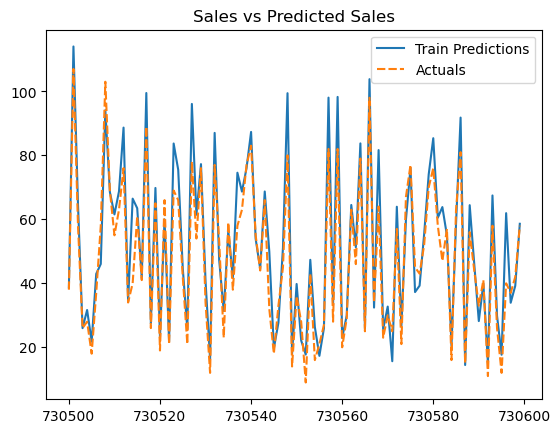

In [42]:
sns.lineplot(data=train_results.head(100))
plt.title("Sales vs Predicted Sales")
plt.show()

In [43]:
df_final_model = df7.copy()
test = df_final_model.loc[(df_final_model["date"] >=  "2018-01-01"), :]
X_test = test[cols]

X_test

,YEAR_cos_index,YEAR_sin_index,dayofyear,dayofmonth,weekofyear,sales_lag_91,sales_lag_98,sales_lag_105,sales_lag_112,sales_lag_119,...,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018,season_0,season_1,season_2,season_3
0,1.000000,0.000000,1,1,1,12.0,14.0,22.0,16.0,12.0,...,0,0,0,0,0,1,1,0,0,0
1,0.999852,0.017202,2,2,1,18.0,18.0,21.0,20.0,26.0,...,0,0,0,0,0,1,1,0,0,0
2,0.999408,0.034399,3,3,1,15.0,27.0,20.0,13.0,24.0,...,0,0,0,0,0,1,1,0,0,0
3,0.998669,0.051585,4,4,1,20.0,23.0,20.0,26.0,29.0,...,0,0,0,0,0,1,1,0,0,0
4,0.997633,0.068757,5,5,1,19.0,28.0,28.0,28.0,28.0,...,0,0,0,0,0,1,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44995,0.108347,0.994113,86,27,13,41.0,54.0,67.0,68.0,68.0,...,0,0,0,0,0,1,0,1,0,0
44996,0.091230,0.995830,87,28,13,63.0,51.0,67.0,60.0,76.0,...,0,0,0,0,0,1,0,1,0,0
44997,0.074087,0.997252,88,29,13,59.0,63.0,72.0,66.0,73.0,...,0,0,0,0,0,1,0,1,0,0
44998,0.056921,0.998379,89,30,13,74.0,75.0,72.0,67.0,66.0,...,0,0,0,0,0,1,0,1,0,0


In [44]:
test_predictions = NN_model.predict(X_test).flatten()
test_results = pd.DataFrame(data={'Test Predictions': np.expm1(test_predictions)})

test_results

1407/1407 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step


,Test Predictions
0,12.272571
1,14.784669
2,14.520985
3,16.753160
4,18.740906
...,...
44995,78.332863
44996,77.802734
44997,81.825317
44998,84.000366


In [45]:
new_test = pd.read_csv('test.csv', parse_dates = ['date'])

result_df = test.loc[:, ['id', 'sales']]
result_df['sales'] = np.expm1(test_predictions)
result_df = pd.concat([ new_test, result_df], axis=1)
result_df = result_df.drop('id', axis=1)

result_df

,date,store,item,sales
0,2018-01-01,1,1,12.272571
1,2018-01-02,1,1,14.784669
2,2018-01-03,1,1,14.520985
3,2018-01-04,1,1,16.753160
4,2018-01-05,1,1,18.740906
...,...,...,...,...
44995,2018-03-27,10,50,78.332863
44996,2018-03-28,10,50,77.802734
44997,2018-03-29,10,50,81.825317
44998,2018-03-30,10,50,84.000366


In [46]:
result_df.to_csv('result_prediction.csv', index=False)

In [47]:
train = pd.read_csv('train.csv', parse_dates = ['date'])
plot_test = pd.concat([ train, result_df], axis=0).reset_index()

plot_test

,index,date,store,item,sales
0,0,2013-01-01,1,1,13.000000
1,1,2013-01-02,1,1,11.000000
2,2,2013-01-03,1,1,14.000000
3,3,2013-01-04,1,1,13.000000
4,4,2013-01-05,1,1,10.000000
...,...,...,...,...,...
957995,44995,2018-03-27,10,50,78.332863
957996,44996,2018-03-28,10,50,77.802734
957997,44997,2018-03-29,10,50,81.825317
957998,44998,2018-03-30,10,50,84.000366


In [48]:
daily_result = plot_test.groupby('date', as_index=False)['sales'].sum()
daily_stores = plot_test.groupby(['store', 'date'], as_index=False)['sales'].sum()
daily_items = plot_test.groupby(['item', 'date'], as_index=False)['sales'].sum()

In [49]:
daily_result

,date,sales
0,2013-01-01,13696.000000
1,2013-01-02,13678.000000
2,2013-01-03,14488.000000
3,2013-01-04,15677.000000
4,2013-01-05,16237.000000
...,...,...
1911,2018-03-27,27140.506642
1912,2018-03-28,27126.579303
1913,2018-03-29,29054.931202
1914,2018-03-30,31172.210512


In [50]:
daily_stores

,store,date,sales
0,1,2013-01-01,1316.000000
1,1,2013-01-02,1264.000000
2,1,2013-01-03,1305.000000
3,1,2013-01-04,1452.000000
4,1,2013-01-05,1499.000000
...,...,...,...
19155,10,2018-03-27,3082.305391
19156,10,2018-03-28,3090.380421
19157,10,2018-03-29,3270.120977
19158,10,2018-03-30,3520.470757


In [51]:
daily_items

,item,date,sales
0,1,2013-01-01,133.000000
1,1,2013-01-02,99.000000
2,1,2013-01-03,127.000000
3,1,2013-01-04,145.000000
4,1,2013-01-05,149.000000
...,...,...,...
95795,50,2018-03-27,675.181934
95796,50,2018-03-28,679.738689
95797,50,2018-03-29,742.297756
95798,50,2018-03-30,796.687233


In [52]:
import plotly.graph_objs as go
from plotly.offline import iplot

sc = go.Scatter(x=daily_result['date'], y=daily_result['sales'])
layout = go.Layout(title='Daily sales', xaxis=dict(title='Date'), yaxis=dict(title='Sales'))

fig = go.Figure(data=[sc], layout=layout)
iplot(fig)

In [53]:
plot_stores = []

for store in daily_stores['store'].unique():
    c_store = daily_stores[(daily_stores['store'] == store)]
    plot_stores.append(go.Scatter(x=c_store['date'], y=c_store['sales'], name=('Store ' + str(store))))
    
layout = go.Layout(title='Store daily sales', xaxis=dict(title='Date'), yaxis=dict(title='Sales'))

fig = go.Figure(data=plot_stores, layout=layout)
iplot(fig)

In [54]:
plot_items = []

for item in daily_items['item'].unique():
    c_items = daily_items[(daily_items['item'] == item)]
    plot_items.append(go.Scatter(x=c_items['date'],y=c_items['sales'], name=('Item ' + str(item))))
    
layout = go.Layout(title='Item daily sales', xaxis=dict(title='Date'), yaxis=dict(title='Sales'))

fig = go.Figure(data=plot_items, layout=layout)
iplot(fig)